### 

### Imports

In [1]:
import time
import logging
from itertools import tee

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from river import datasets
from river import preprocessing
from river import base, metrics, stats, preprocessing, datasets
from river.drift import ADWIN, NoDrift

In [3]:
SEED = 42

In [4]:
# customly made generators for real datasets
from datasets import Abalone, BikeSharing, Superconductivty, House8L

In [5]:
from evaluation import evaluate_model

help(evaluate_model)

Help on function evaluate_model in module evaluation:

evaluate_model(model, stream, name, print_interval=10000, metric_class=<class 'river.metrics.mae.MAE'>, track_model_count=False, verbose=True)
    Evaluate a River/River-extended regressor model on a data stream.
    
    Args:
        model: River-compatible regressor with `learn_one`, `predict_one`, and optionally `__len__` and `n_drifts_detected`.
        stream: Iterable yielding (x, y) pairs.
        name (str): Display name of the model.
        print_interval (int): Instance step interval to log progress.
        metric_class: River metric class, e.g., metrics.MAE.
        track_model_count (bool): Track number of models in the ensemble.
        verbose (bool): If True, logs progress info using the logging module.
    
    Returns:
        dict: {
            "name": str,
            "metric": river.Metric,
            "mae_history": list,
            "model_count_history": list or None,
            "duration": float (second

### Synthetic Data Streams

In [22]:
#  create the dataset stream and copy it
dataset_generator = datasets.synth.FriedmanDrift(seed=SEED, 
                                                 position=(500,1000,10000)) # add some drift
# use 10k instances to see more drift effects
dataset = dataset_generator.take(10000) 
stream_standard, stream_smart = tee(dataset)

In [23]:
from river.forest import ARFRegressor
import time
import matplotlib.pyplot as plt

In [17]:
from river.forest import ARFRegressor
from models import SmartARFRegressor

N_MODELS_INITIAL = 10

arf_regressor = ARFRegressor(
        n_models=N_MODELS_INITIAL,
        seed=42,
        lambda_value=6,
        grace_period=50,
        leaf_prediction="adaptive",
        metric=metrics.MAE(),
        drift_detector=ADWIN(delta=0.001), # more sensitive drift for standard
        warning_detector=ADWIN(delta=0.01)
    )

smart_arf_regressor = SmartARFRegressor(
        n_models=N_MODELS_INITIAL,       # this is the "desired" initial, might be overridden by min_ensemble_size
        max_models=20,
        min_ensemble_size=5,             # <--- NEW: tell SmartARF to maintain at least 5
        seed=42,
        lambda_value=6,
        grace_period=50,
        leaf_prediction="adaptive",
        metric=metrics.MAE(),
        drift_detector=ADWIN(delta=0.01),
        warning_detector=ADWIN(delta=0.1),
        regression_pruning_error_threshold=0.2,
        accuracy_drop_threshold=0.6,
        monitor_window=200,
        disable_weighted_vote=False,
        verbose_logging=True             # <--- For detailed logs
    )


Evaluating Standard ARF (Fixed Size Implementation)…
Standard ARF evaluation time: 0.00 seconds

Evaluating SmartARFRegressor…
SmartARFRegressor evaluation time: 0.00 seconds

--- Final Results ---
Standard ARF (Fixed Size) Final MAE: 0.0000
SmartARFRegressor Final MAE     : 0.0000


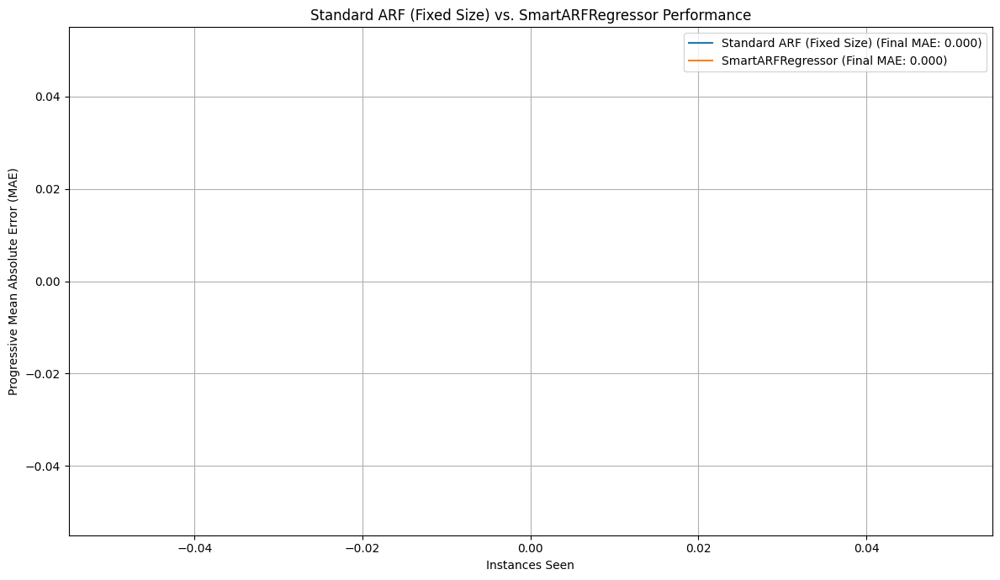


Plotting SmartARFRegressor Ensemble Size Over Time...
No model count history to plot for SmartARFRegressor.

Standard ARF (Fixed Size) final number of models: 0


NameError: name 'logging' is not defined

In [18]:
metric_eval_standard = metrics.MAE()
metric_eval_smart = metrics.MAE()
standard_mae_history = []
smart_mae_history = []

# --- Standard ARF ---
print("Evaluating Standard ARF (Fixed Size Implementation)…")
start_time_standard = time.time()
for i, (x, y) in enumerate(stream_standard):
    y_pred = arf_regressor.predict_one(x)
    if y_pred is not None:
        metric_eval_standard.update(y, y_pred)
        standard_mae_history.append(metric_eval_standard.get())
    else: # Handle cases where prediction might be None (e.g., uninitialized)
        standard_mae_history.append(standard_mae_history[-1] if standard_mae_history else 0.0)
    arf_regressor.learn_one(x, y)
    if (i + 1) % 10000 == 0: # Print less frequently
        num_models = len(arf_regressor)
        print(f"  Standard ARF - Step {i+1}, MAE: {metric_eval_standard.get():.4f}, "
              f"Num Models: {num_models}, Drifts: {arf_regressor.n_drifts_detected()}")
end_time_standard = time.time()
print(f"Standard ARF evaluation time: {end_time_standard - start_time_standard:.2f} seconds")

# --- SmartARFRegressor ---
print("\nEvaluating SmartARFRegressor…")
start_time_smart = time.time()
for i, (x, y) in enumerate(stream_smart):
    y_pred = smart_arf_regressor.predict_one(x)
    if y_pred is not None:
        metric_eval_smart.update(y, y_pred)
        smart_mae_history.append(metric_eval_smart.get())
    else:
        smart_mae_history.append(smart_mae_history[-1] if smart_mae_history else 0.0)
    smart_arf_regressor.learn_one(x, y)
    if (i + 1) % 10000 == 0: # Print less frequently
        num_models = len(smart_arf_regressor)
        print(f"  SmartARF - Step {i+1}, MAE: {metric_eval_smart.get():.4f}, "
              f"Num Models: {num_models}, Drifts: {smart_arf_regressor.n_drifts_detected()}")
end_time_smart = time.time()
print(f"SmartARFRegressor evaluation time: {end_time_smart - start_time_smart:.2f} seconds")

# 5. Final metrics
print("\n--- Final Results ---")
print(f"Standard ARF (Fixed Size) Final MAE: {metric_eval_standard.get():.4f}")
print(f"SmartARFRegressor Final MAE     : {metric_eval_smart.get():.4f}")

# 6. Plotting Performance
plt.figure(figsize=(12, 7))
plt.plot(standard_mae_history, label=f"Standard ARF (Fixed Size) (Final MAE: {metric_eval_standard.get():.3f})")
plt.plot(smart_mae_history, label=f"SmartARFRegressor (Final MAE: {metric_eval_smart.get():.3f})")
plt.xlabel("Instances Seen")
plt.ylabel("Progressive Mean Absolute Error (MAE)")
plt.title("Standard ARF (Fixed Size) vs. SmartARFRegressor Performance")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# 7. Plotting Ensemble Size for SmartARFRegressor
if hasattr(smart_arf_regressor, 'plot_model_count'):
    print("\nPlotting SmartARFRegressor Ensemble Size Over Time...")
    smart_arf_regressor.plot_model_count(mark_warnings=True, mark_drifts=True)
else:
    print("SmartARFRegressor instance does not have a 'plot_model_count' method.")

num_standard_models_final = len(arf_regressor)
print(f"\nStandard ARF (Fixed Size) final number of models: {num_standard_models_final}")
if N_MODELS_INITIAL > 0 and num_standard_models_final != N_MODELS_INITIAL :
     # This warning is now more relevant as standard ARF is designed to be fixed-size.
     # However, during initialization or if n_models=0, it might differ.
     # For a fixed-size ARF, this should ideally always be N_MODELS_INITIAL after first learn_one if N_MODELS_INITIAL > 0.
     logging.warning(f"Standard ARF model count ({num_standard_models_final}) "
                    f"differs from initial n_models ({N_MODELS_INITIAL}). This should not happen for fixed-size ARF after initialization.")
elif N_MODELS_INITIAL == 0 and num_standard_models_final == 0:
     print("Standard ARF n_models was 0, so no models were initialized, as expected.")

# Real Data Streams

Datasets inspired by work:

*Sun, Yibin & Gomes, Heitor Murilo & Pfahringer, Bernhard & Bifet, Albert. (2025). Evaluation for Regression Analyses on Evolving Data Streams. 10.48550/arXiv.2502.07213.*

### Abalone dataset

In [6]:
from datasets import Abalone
from itertools import tee

abalone_stream = Abalone().load_stream()
stream_standard, stream_smart = tee(abalone_stream)

In [7]:
from models import make_smart_arf, make_standard_arf

N_MODELS_INITIAL = 10

arf = make_standard_arf()
smart_arf = make_smart_arf()

In [8]:
from evaluation import evaluate_model

arf_abalone_results = evaluate_model(
    model=arf,
    name="ARFStandard",
    stream=stream_standard,
    verbose=True
)

In [10]:
from evaluation import evaluate_model

smart_arf_abalone_results = evaluate_model(
    model=smart_arf,
    name="SmartARF",
    stream=stream_smart,
    track_model_count=True,
    verbose=True   
)

[SmartARF Step 1] First learn_one. Effective n_models=10, max_models=20, min_ensemble_size=5
[SmartARF Step 1] Start learn_one. Current ensemble size: 10
[SmartARF Step 1] End learn_one. Final ensemble size: 10
[SmartARF Step 2] Start learn_one. Current ensemble size: 10
[SmartARF Step 2] End learn_one. Final ensemble size: 10
[SmartARF Step 3] Start learn_one. Current ensemble size: 10
[SmartARF Step 3] End learn_one. Final ensemble size: 10
[SmartARF Step 4] Start learn_one. Current ensemble size: 10
[SmartARF Step 4] End learn_one. Final ensemble size: 10
[SmartARF Step 5] Start learn_one. Current ensemble size: 10
[SmartARF Step 5] End learn_one. Final ensemble size: 10
[SmartARF Step 6] Start learn_one. Current ensemble size: 10
[SmartARF Step 6] End learn_one. Final ensemble size: 10
[SmartARF Step 7] Start learn_one. Current ensemble size: 10
[SmartARF Step 7] End learn_one. Final ensemble size: 10
[SmartARF Step 8] Start learn_one. Current ensemble size: 10
[SmartARF Step 8] En

In [12]:
print("\n--- Final Results ---")
print(f"Standard ARF (Fixed Size) Final: {arf_abalone_results.get('metric')}")
print(f"SmartARFRegressor Final        : {smart_arf_abalone_results.get('metric')}")


--- Final Results ---
Standard ARF (Fixed Size) Final: MAE: 1.393624
SmartARFRegressor Final        : MAE: 1.417873


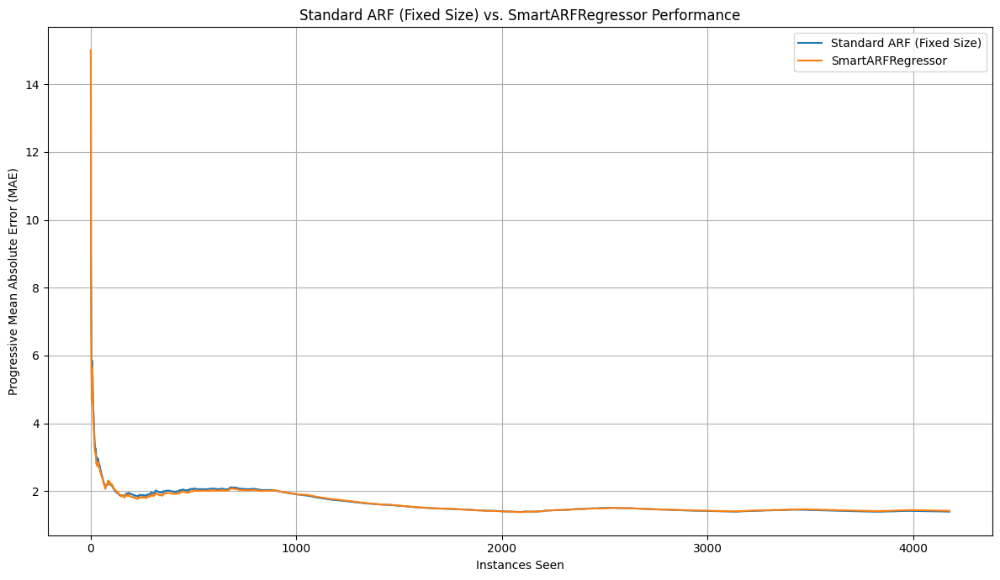

In [ ]:
# Plotting Performance
plt.figure(figsize=(12, 7))
plt.plot(arf_abalone_results.get("mae_history"), 
         label=f"Standard ARF (Fixed Size)") # # (Final MAE: {metric_eval_standard.get():.3f})")
plt.plot(smart_arf_abalone_results.get("mae_history"),
         label=f"SmartARFRegressor") # (Final MAE: {metric_eval_smart.get():.3f})")
plt.xlabel("Instances Seen")
plt.ylabel("Progressive Mean Absolute Error (MAE)")
plt.title("Standard ARF (Fixed Size) vs. SmartARFRegressor Performance")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


Plotting SmartARFRegressor Ensemble Size Over Time...


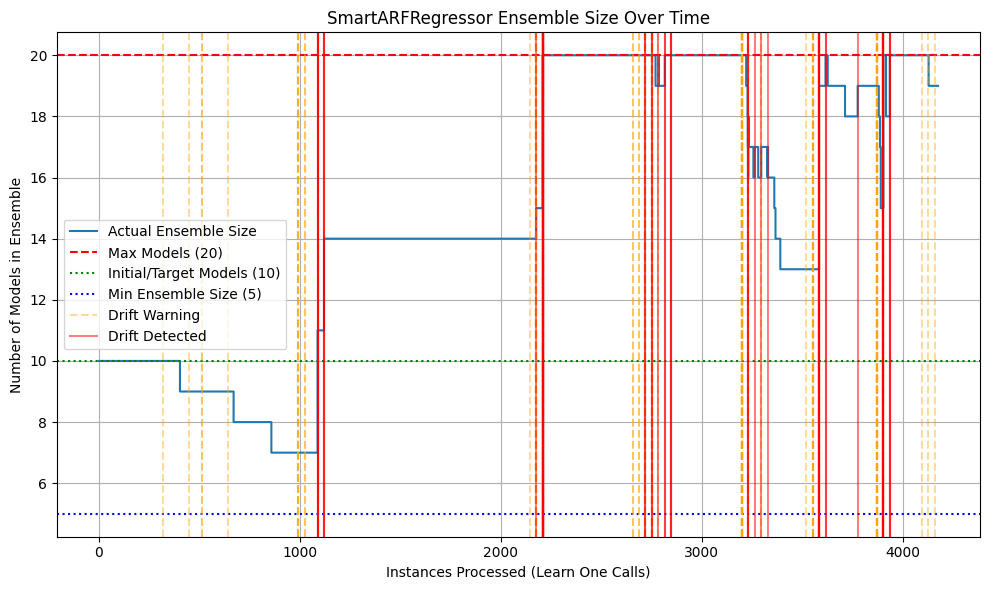

In [22]:
# Plotting Ensemble Size for SmartARFRegressor
if hasattr(smart_arf, 'plot_model_count'):
    print("\nPlotting SmartARFRegressor Ensemble Size Over Time...")
    smart_arf.plot_model_count(mark_warnings=True, mark_drifts=True)
else:
    print("SmartARFRegressor instance does not have a 'plot_model_count' method.")

### Superconductivity

In [6]:
from datasets import Superconductivty
from itertools import tee

superconductivty_stream = Superconductivty().load_stream()
stream_standard, stream_smart = tee(superconductivty_stream)

In [7]:
from models import make_smart_arf, make_standard_arf

N_MODELS_INITIAL = 10

arf = make_standard_arf()
smart_arf = make_smart_arf()

In [8]:
from evaluation import evaluate_model

arf_superconductivty_results = evaluate_model(
    model=arf,
    name="ARFStandard",
    stream=stream_standard,
    verbose=True
)

In [9]:
from evaluation import evaluate_model

smart_arf_superconductivty_results = evaluate_model(
    model=smart_arf,
    name="SmartARF",
    stream=stream_smart,
    track_model_count=True,
    verbose=True
)

[SmartARF Step 1] First learn_one. Effective n_models=10, max_models=20, min_ensemble_size=5
[SmartARF Step 1] Start learn_one. Current ensemble size: 10
[SmartARF Step 1] End learn_one. Final ensemble size: 10
[SmartARF Step 2] Start learn_one. Current ensemble size: 10
[SmartARF Step 2] End learn_one. Final ensemble size: 10
[SmartARF Step 3] Start learn_one. Current ensemble size: 10
[SmartARF Step 3] End learn_one. Final ensemble size: 10
[SmartARF Step 4] Start learn_one. Current ensemble size: 10
[SmartARF Step 4] End learn_one. Final ensemble size: 10
[SmartARF Step 5] Start learn_one. Current ensemble size: 10
[SmartARF Step 5] End learn_one. Final ensemble size: 10
[SmartARF Step 6] Start learn_one. Current ensemble size: 10
[SmartARF Step 6] End learn_one. Final ensemble size: 10
[SmartARF Step 7] Start learn_one. Current ensemble size: 10
[SmartARF Step 7] End learn_one. Final ensemble size: 10
[SmartARF Step 8] Start learn_one. Current ensemble size: 10
[SmartARF Step 8] En

In [10]:
print("\n--- Final Results ---")
print(f"Standard ARF (Fixed Size) Final: {arf_superconductivty_results.get('metric')}")
print(f"SmartARFRegressor Final        : {smart_arf_superconductivty_results.get('metric')}")


--- Final Results ---
Standard ARF (Fixed Size) Final: MAE: 29,066.408408
SmartARFRegressor Final        : MAE: 27,726.533473


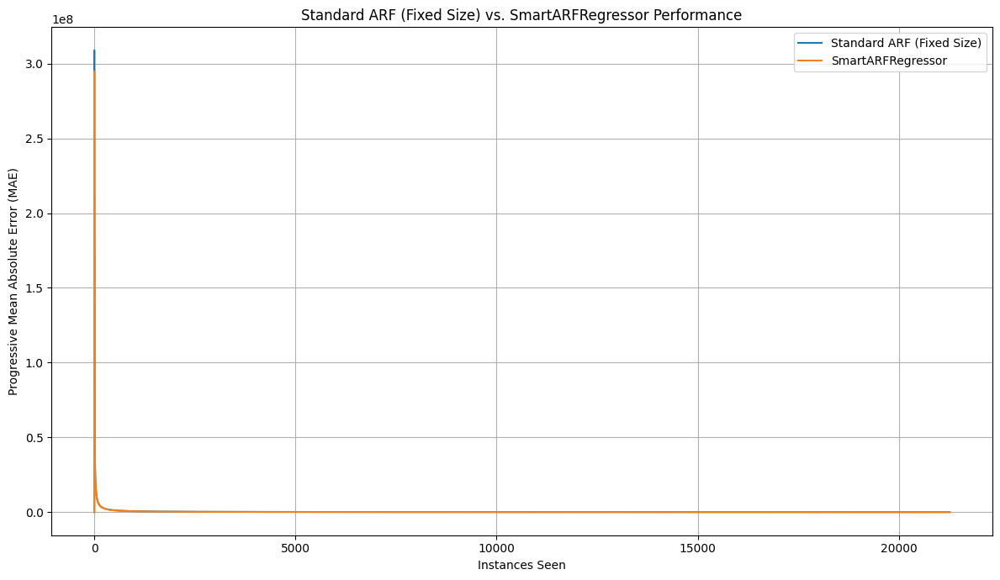

In [11]:
# Plotting Performance
plt.figure(figsize=(12, 7))
plt.plot(arf_superconductivty_results.get("mae_history"), 
         label=f"Standard ARF (Fixed Size)") # # (Final MAE: {metric_eval_standard.get():.3f})")
plt.plot(smart_arf_superconductivty_results.get("mae_history"),
         label=f"SmartARFRegressor") # (Final MAE: {metric_eval_smart.get():.3f})")
plt.xlabel("Instances Seen")
plt.ylabel("Progressive Mean Absolute Error (MAE)")
plt.title("Standard ARF (Fixed Size) vs. SmartARFRegressor Performance")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


Plotting SmartARFRegressor Ensemble Size Over Time...


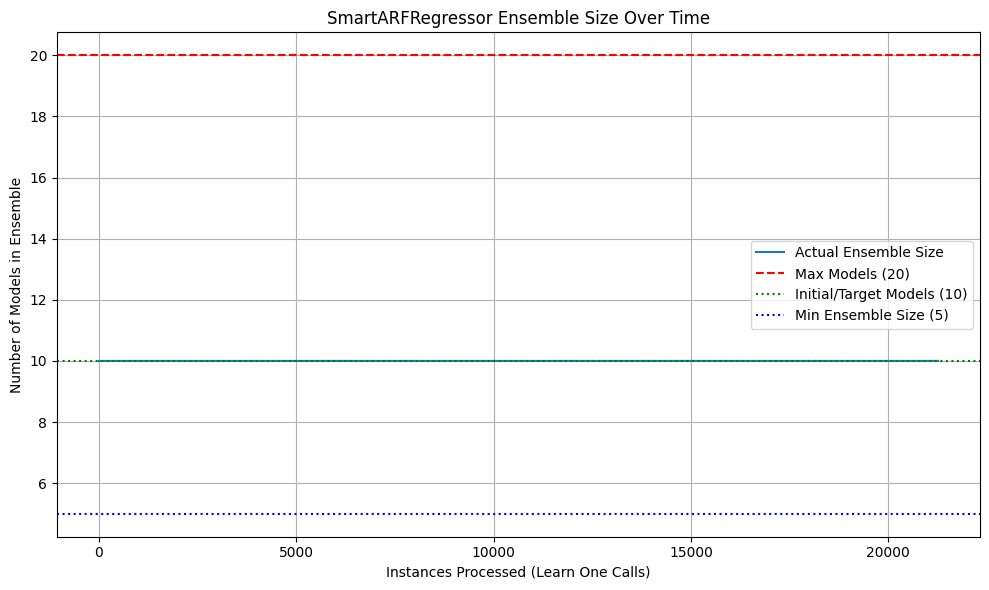

In [12]:
# Plotting Ensemble Size for SmartARFRegressor
if hasattr(smart_arf, 'plot_model_count'):
    print("\nPlotting SmartARFRegressor Ensemble Size Over Time...")
    smart_arf.plot_model_count(mark_warnings=True, mark_drifts=True)
else:
    print("SmartARFRegressor instance does not have a 'plot_model_count' method.")

### House8L

In [17]:
from datasets import House8L
from itertools import tee

house8l_stream = House8L().load_stream()
stream_standard, stream_smart = tee(house8l_stream)

In [18]:
from models import make_smart_arf, make_standard_arf

N_MODELS_INITIAL = 10

arf = make_standard_arf()
smart_arf = make_smart_arf()

In [19]:
from evaluation import evaluate_model

arf_house8l_results = evaluate_model(
    model=arf,
    name="ARFStandard",
    stream=stream_standard,
    verbose=True
)

In [20]:
from evaluation import evaluate_model

smart_arf_house8l_results = evaluate_model(
    model=smart_arf,
    name="SmartARF",
    stream=stream_smart,
    track_model_count=True,
    verbose=True
)

[SmartARF Step 1] First learn_one. Effective n_models=10, max_models=20, min_ensemble_size=5
[SmartARF Step 1] Start learn_one. Current ensemble size: 10
[SmartARF Step 1] End learn_one. Final ensemble size: 10
[SmartARF Step 2] Start learn_one. Current ensemble size: 10
[SmartARF Step 2] End learn_one. Final ensemble size: 10
[SmartARF Step 3] Start learn_one. Current ensemble size: 10
[SmartARF Step 3] End learn_one. Final ensemble size: 10
[SmartARF Step 4] Start learn_one. Current ensemble size: 10
[SmartARF Step 4] End learn_one. Final ensemble size: 10
[SmartARF Step 5] Start learn_one. Current ensemble size: 10
[SmartARF Step 5] End learn_one. Final ensemble size: 10
[SmartARF Step 6] Start learn_one. Current ensemble size: 10
[SmartARF Step 6] End learn_one. Final ensemble size: 10
[SmartARF Step 7] Start learn_one. Current ensemble size: 10
[SmartARF Step 7] End learn_one. Final ensemble size: 10
[SmartARF Step 8] Start learn_one. Current ensemble size: 10
[SmartARF Step 8] En

In [21]:
print("\n--- Final Results ---")
print(f"Standard ARF (Fixed Size) Final: {arf_superconductivty_results.get('metric')}")
print(f"SmartARFRegressor Final        : {smart_arf_superconductivty_results.get('metric')}")


--- Final Results ---
Standard ARF (Fixed Size) Final: MAE: 29,066.408408
SmartARFRegressor Final        : MAE: 27,726.533473


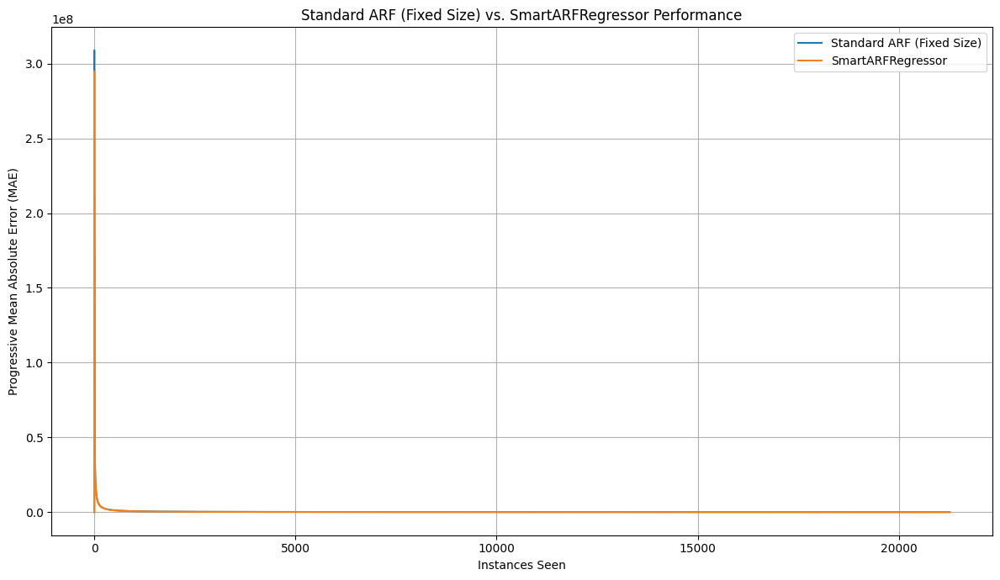

In [22]:
# Plotting Performance
plt.figure(figsize=(12, 7))
plt.plot(arf_superconductivty_results.get("mae_history"), 
         label=f"Standard ARF (Fixed Size)") # # (Final MAE: {metric_eval_standard.get():.3f})")
plt.plot(smart_arf_superconductivty_results.get("mae_history"),
         label=f"SmartARFRegressor") # (Final MAE: {metric_eval_smart.get():.3f})")
plt.xlabel("Instances Seen")
plt.ylabel("Progressive Mean Absolute Error (MAE)")
plt.title("Standard ARF (Fixed Size) vs. SmartARFRegressor Performance")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


Plotting SmartARFRegressor Ensemble Size Over Time...


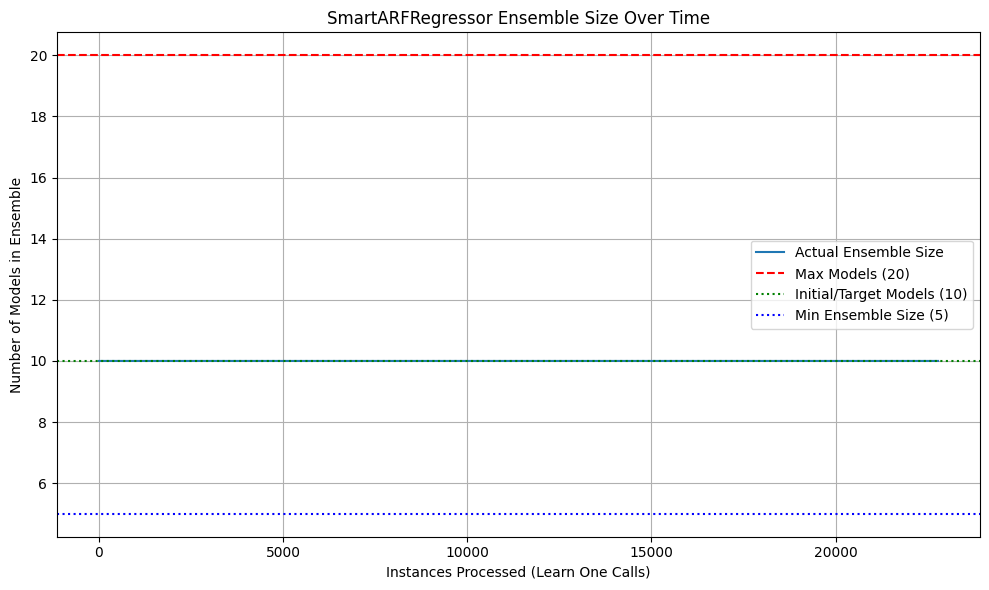

In [23]:
# Plotting Ensemble Size for SmartARFRegressor
if hasattr(smart_arf, 'plot_model_count'):
    print("\nPlotting SmartARFRegressor Ensemble Size Over Time...")
    smart_arf.plot_model_count(mark_warnings=True, mark_drifts=True)
else:
    print("SmartARFRegressor instance does not have a 'plot_model_count' method.")

### Bike sharing dataset (excluded)

Comment: The bike dataset does not seem to be appropriate for the kind of model we chose (ARF).

In [23]:
from datasets import BikeSharing
from itertools import tee

bike_stream = BikeSharing().load_stream()
stream_standard, stream_smart = tee(bike_stream)

In [24]:
from models import make_smart_arf, make_standard_arf

N_MODELS_INITIAL = 10

arf = make_standard_arf()
smart_arf = make_smart_arf()

In [25]:
from evaluation import evaluate_model

arf_bike_results = evaluate_model(
    model=arf,
    name="ARFStandard",
    stream=stream_standard,
    verbose=True
)

In [27]:
from evaluation import evaluate_model

smart_arf_bike_results = evaluate_model(
    model=smart_arf,
    name="SmartARF",
    stream=stream_smart,
    track_model_count=True,
    verbose=True   
)

[SmartARF Step 1] First learn_one. Effective n_models=10, max_models=20, min_ensemble_size=5
[SmartARF Step 1] Start learn_one. Current ensemble size: 10
[SmartARF Step 1] End learn_one. Final ensemble size: 10
[SmartARF Step 2] Start learn_one. Current ensemble size: 10
[SmartARF Step 2] End learn_one. Final ensemble size: 10
[SmartARF Step 3] Start learn_one. Current ensemble size: 10
[SmartARF Step 3] End learn_one. Final ensemble size: 10
[SmartARF Step 4] Start learn_one. Current ensemble size: 10
[SmartARF Step 4] End learn_one. Final ensemble size: 10
[SmartARF Step 5] Start learn_one. Current ensemble size: 10
[SmartARF Step 5] End learn_one. Final ensemble size: 10
[SmartARF Step 6] Start learn_one. Current ensemble size: 10
[SmartARF Step 6] End learn_one. Final ensemble size: 10
[SmartARF Step 7] Start learn_one. Current ensemble size: 10
[SmartARF Step 7] End learn_one. Final ensemble size: 10
[SmartARF Step 8] Start learn_one. Current ensemble size: 10
[SmartARF Step 8] En

In [29]:
print("\n--- Final Results ---")
print(f"Standard ARF (Fixed Size) Final: {arf_bike_results.get('metric')}")
print(f"SmartARFRegressor Final        : {smart_arf_bike_results.get('metric')}")


--- Final Results ---
Standard ARF (Fixed Size) Final: MAE: 72.449278
SmartARFRegressor Final        : MAE: 74.461471


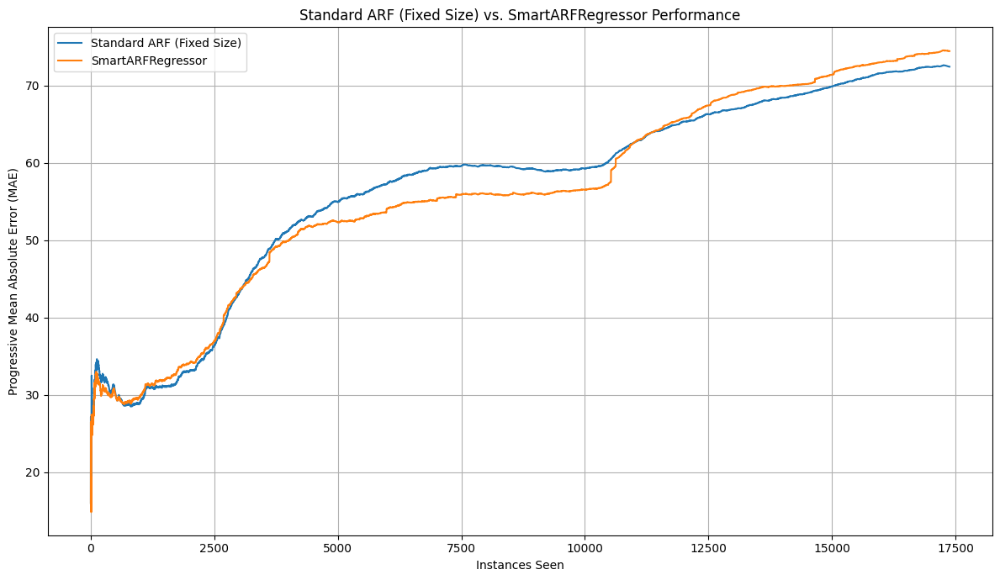

In [30]:
# Plotting Performance
plt.figure(figsize=(12, 7))
plt.plot(arf_bike_results.get("mae_history"), 
         label=f"Standard ARF (Fixed Size)") # # (Final MAE: {metric_eval_standard.get():.3f})")
plt.plot(smart_arf_bike_results.get("mae_history"),
         label=f"SmartARFRegressor") # (Final MAE: {metric_eval_smart.get():.3f})")
plt.xlabel("Instances Seen")
plt.ylabel("Progressive Mean Absolute Error (MAE)")
plt.title("Standard ARF (Fixed Size) vs. SmartARFRegressor Performance")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


Plotting SmartARFRegressor Ensemble Size Over Time...


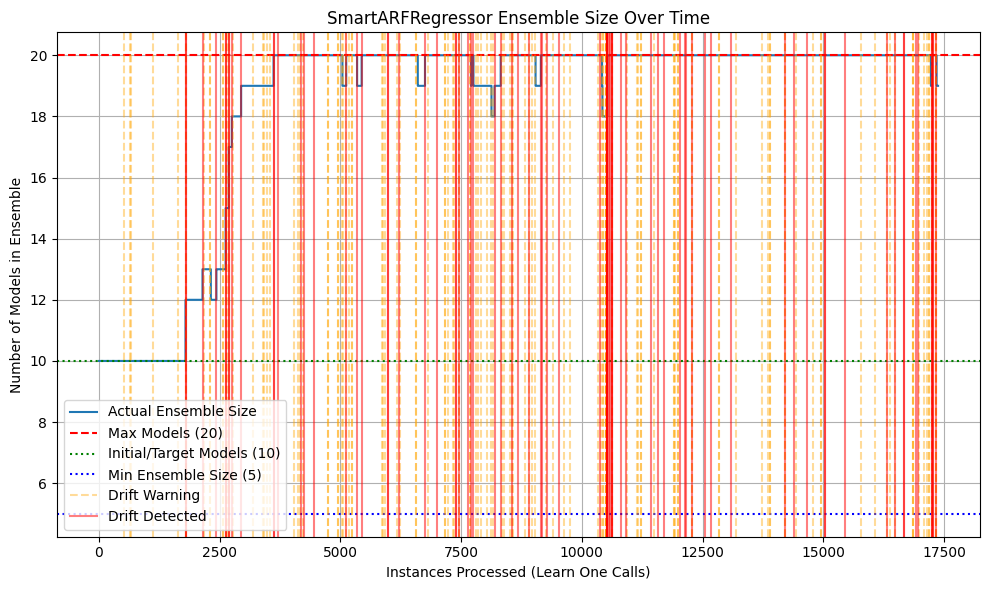

In [31]:
# Plotting Ensemble Size for SmartARFRegressor
if hasattr(smart_arf, 'plot_model_count'):
    print("\nPlotting SmartARFRegressor Ensemble Size Over Time...")
    smart_arf.plot_model_count(mark_warnings=True, mark_drifts=True)
else:
    print("SmartARFRegressor instance does not have a 'plot_model_count' method.")